In [12]:
pip install imutils

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25854 sha256=291c1146a0bc41897ed2060d2454359e15979e9016e7d28a3fc9513803b52c6b
  Stored in directory: c:\users\kisha\appdata\local\pip\cache\wheels\31\d0\2c\87ce38f6052879e5b7b18f0f8b4a10ad2a9d210e908d449f16
Successfully built imutils
Note: you may need to restart the kernel to use updated packages.


(-0.5, 1159.5, 521.5, -0.5)

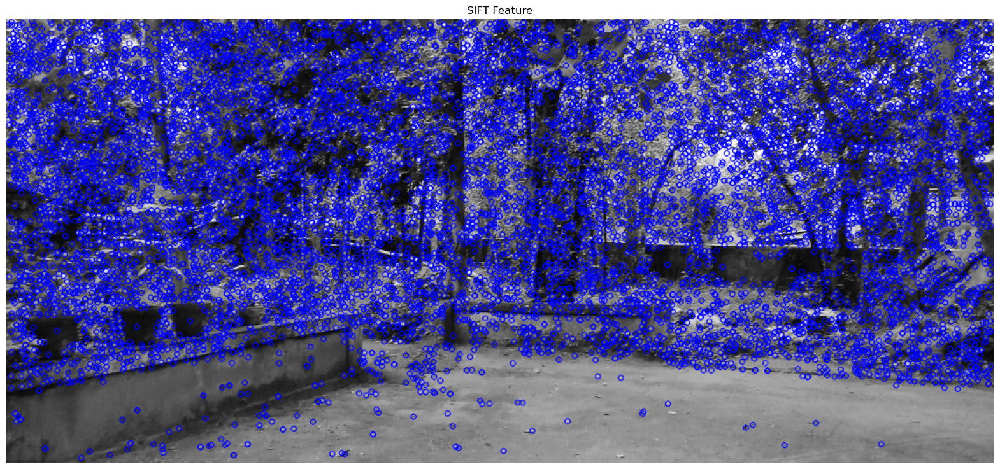

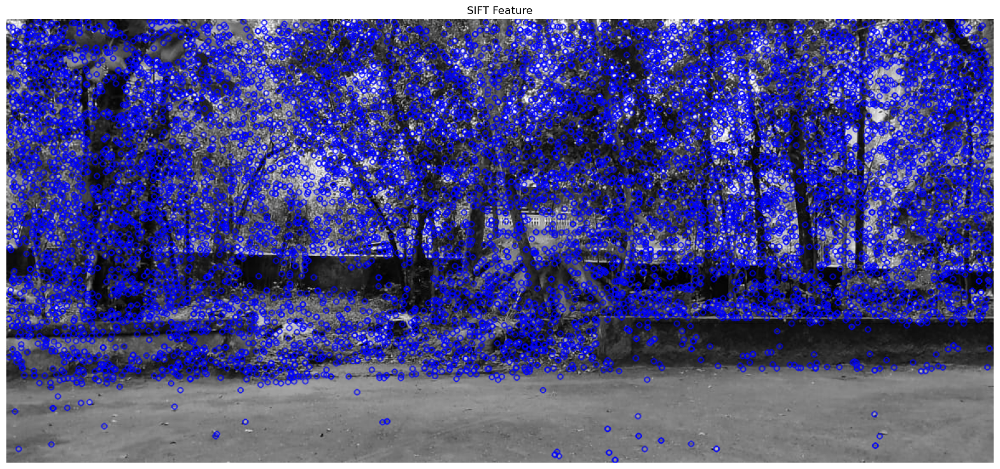

In [7]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
 
img1 = cv.imread('C://Users//Kisha//OneDrive//Documents//finalYearProject//10_1.jpg')  # queryImage
img2 = cv.imread('C://Users//Kisha//OneDrive//Documents//finalYearProject//10_2.jpg') # trainImage

grayimg1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
grayimg2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#Creating SIFT object
sift = cv2.SIFT_create()

#Finding keypoints and descriptors for Mountain images
keyp1, desc1 = sift.detectAndCompute(grayimg1, None)
keyp2, desc2 = sift.detectAndCompute(grayimg2, None)

#Drawing keypoints for Mountain images
keyImage1 = cv2.drawKeypoints(grayimg1, keyp1, np.array([]), (0, 0, 255))
keyImage2 = cv2.drawKeypoints(grayimg2, keyp2, np.array([]), (0, 0, 255))

plt.figure(figsize=(20, 20))  
plt.imshow(keyImage1)
plt.title("SIFT Feature")
plt.axis('off') 

plt.figure(figsize=(20, 20))  
plt.imshow(keyImage2)
plt.title("SIFT Feature")
plt.axis('off') 

(-0.5, 2319.5, 521.5, -0.5)

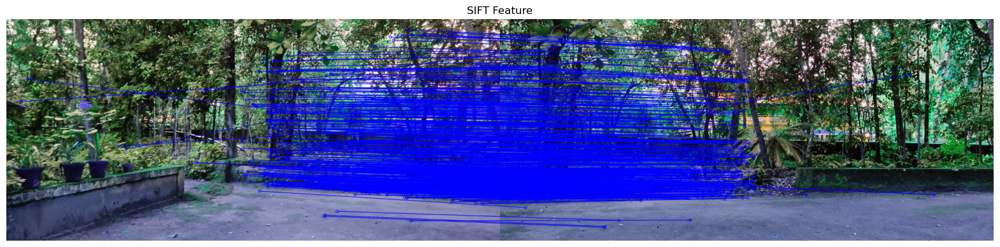

In [10]:
brutef = cv2.BFMatcher()

#Matching the keypoints with k-nearest neighbor (with k=2)
matches = brutef.knnMatch(desc1, desc2, k=2)

goodMatch = []
#Performing ratio test to find good matches
for m, n in matches:
	if m.distance < 0.75*n.distance:
		goodMatch.append(m)

#Drawing good matches
matchImage = cv2.drawMatches(img1, keyp1, img2, keyp2, goodMatch, np.array([]), (0, 0, 255), flags=2)

plt.figure(figsize=(20, 20))  
plt.imshow(matchImage)
plt.title("SIFT Feature")
plt.axis('off') 

In [11]:
srce_pts = np.float32([ keyp1[m.queryIdx].pt for m in goodMatch]).reshape(-1, 1, 2)
dest_pts = np.float32([ keyp2[m.trainIdx].pt for m in goodMatch]).reshape(-1, 1, 2)

#Finding Homography Matrix and mask
homographyMat, mask = cv2.findHomography(srce_pts, dest_pts, cv2.RANSAC, 5.0)
print(homographyMat)

[[ 2.79237081e+00 -4.23521129e-02 -1.52701729e+03]
 [ 4.22166917e-01  2.25446461e+00 -3.19850628e+02]
 [ 1.52851740e-03 -2.02129035e-05  1.00000000e+00]]


(-0.5, 2319.5, 521.5, -0.5)

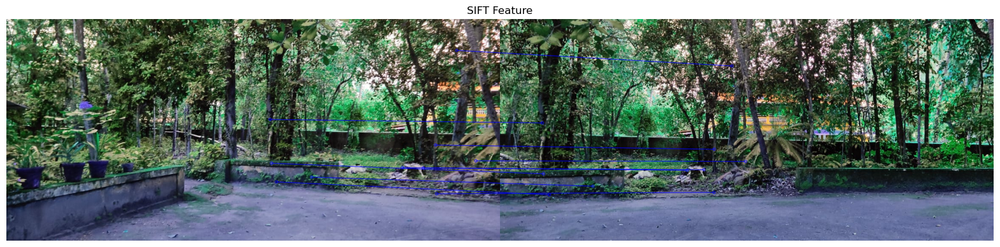

In [14]:
matchesMask = mask.ravel().tolist()

UBIT = "rgupta24"

h, w = img1.shape[:2]
pts = np.float32([[0,0], [0,h-1], [w-1,h-1], [w-1,0]]).reshape(-1, 1, 2)

matchIndex = []
for i in range(len(matchesMask)):
	if (matchesMask[i]):
		matchIndex.append(i)

matchArray = []
for i in matchIndex:
	matchArray.append(goodMatch[i])

#Finding 10 random matches using inliers
np.random.seed(sum([ord(c) for c in UBIT]))
randomMatch = np.random.choice(matchArray, 10, replace=False)

#Defining draw parameters
draw_params = dict(matchColor=(0, 0, 255),
                   singlePointColor=None,
                   flags=2)

#Drawing the match image for 10 random points
matchImage = cv2.drawMatches(img1, keyp1, img2, keyp2, randomMatch, None, **draw_params)

plt.figure(figsize=(20, 20))  
plt.imshow(matchImage)
plt.title("SIFT Feature")
plt.axis('off') 

(-0.5, 2725.5, 1185.5, -0.5)

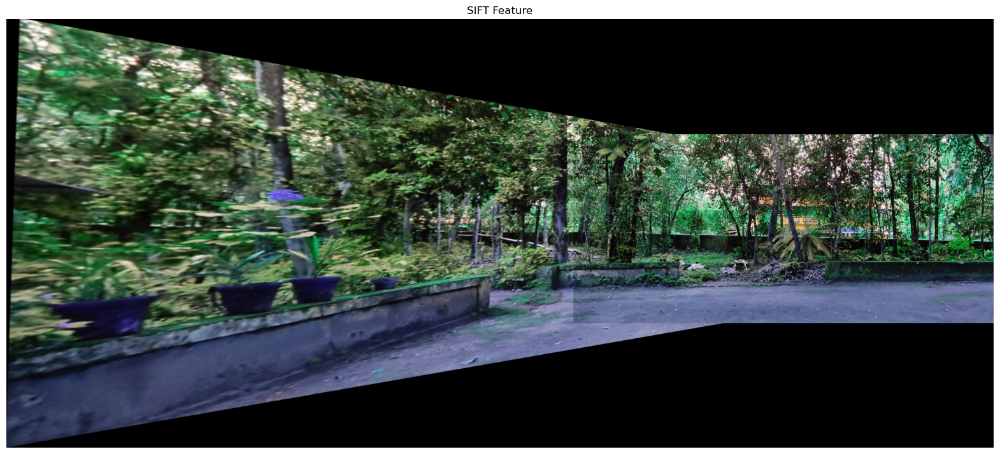

In [15]:
h1, w1 = img2.shape[:2]
h2, w2 = img1.shape[:2]
pts1 = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
pts2 = np.float32([[0, 0], [0, h2], [w2, h2], [w2, 0]]).reshape(-1, 1, 2)
pts2_ = cv2.perspectiveTransform(pts2, homographyMat)
pts = np.concatenate((pts1, pts2_), axis=0)

#Finding the minimum and maximum coordinates
[xmin, ymin] = np.int32(pts.min(axis=0).ravel() - 0.5)
[xmax, ymax] = np.int32(pts.max(axis=0).ravel() + 0.5)
t = [-xmin, -ymin]

#Translating
Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])

#Warping the first image on the second image using Homography Matrix
result = cv2.warpPerspective(img1, Ht.dot(homographyMat), (xmax-xmin, ymax-ymin))
result[t[1]:h1+t[1], t[0]:w1+t[0]] = img2

plt.figure(figsize=(20, 20))  
plt.imshow(result)
plt.title("SIFT Feature")
plt.axis('off') 

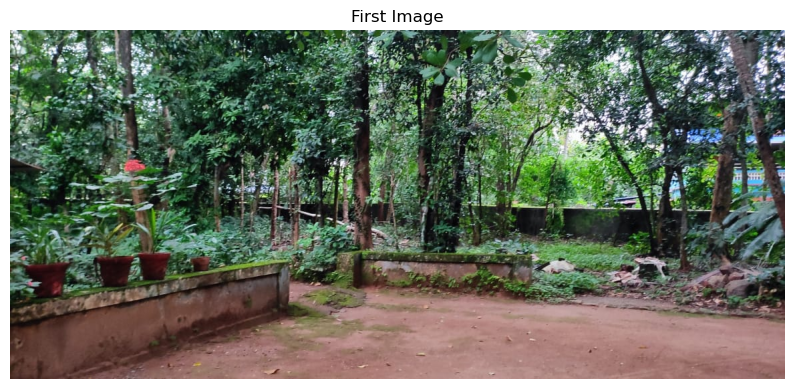

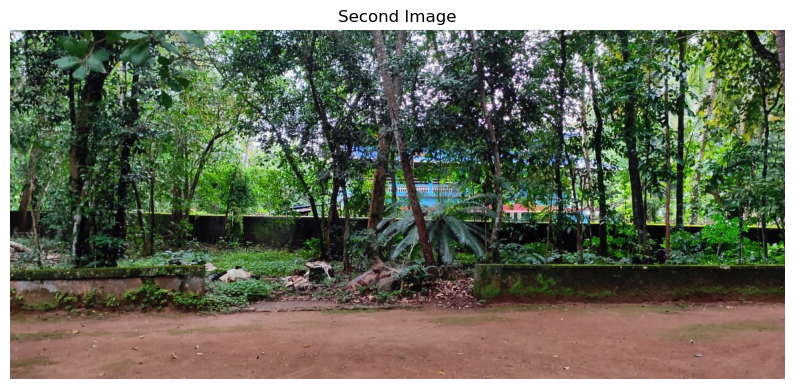

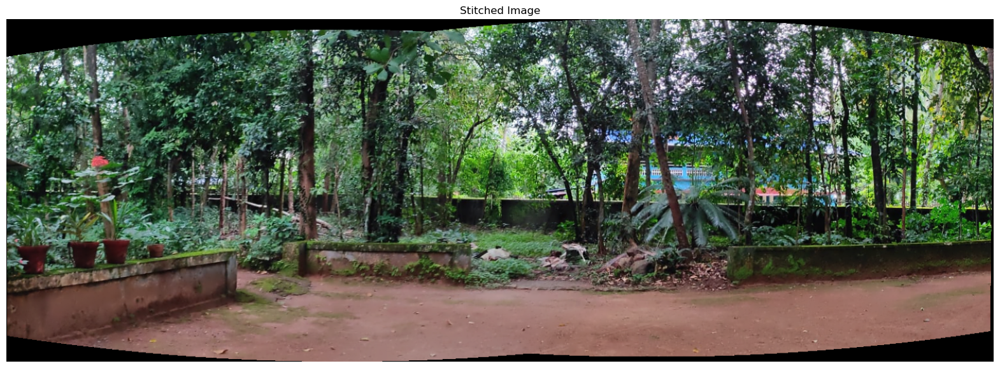

In [21]:
import cv2 
import matplotlib.pyplot as plt
image_paths=['C://Users//Kisha//OneDrive//Documents//finalYearProject//10_1.jpg','C://Users//Kisha//OneDrive//Documents//finalYearProject//10_2.jpg'] 
imgs = []
for imagePath in image_paths:
    image = cv2.imread(imagePath)
    imgs.append(image)
plt.figure(figsize=(10, 20))
plt.imshow(cv2.cvtColor(imgs[0], cv2.COLOR_BGR2RGB))
plt.title("First Image")
plt.axis('off')  
plt.show()

plt.figure(figsize=(10, 20)) 
plt.imshow(cv2.cvtColor(imgs[1], cv2.COLOR_BGR2RGB))
plt.title("Second Image")
plt.axis('off') 
plt.show()

stitchy=cv2.Stitcher_create() 
(dummy,output)=stitchy.stitch(imgs) 
plt.figure(figsize=(20, 20))  
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title("Stitched Image")
plt.axis('off') 
plt.show()

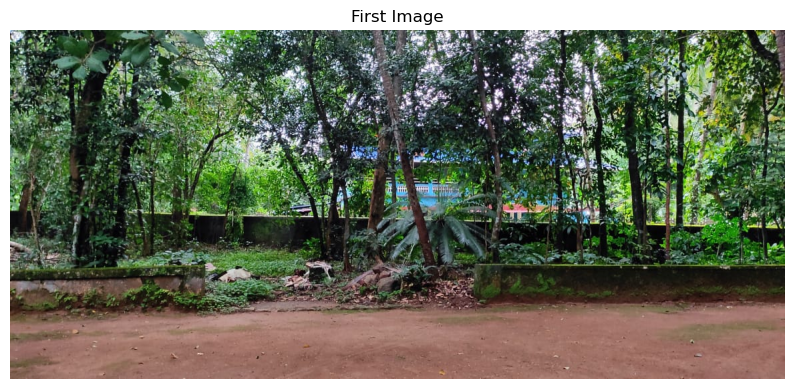

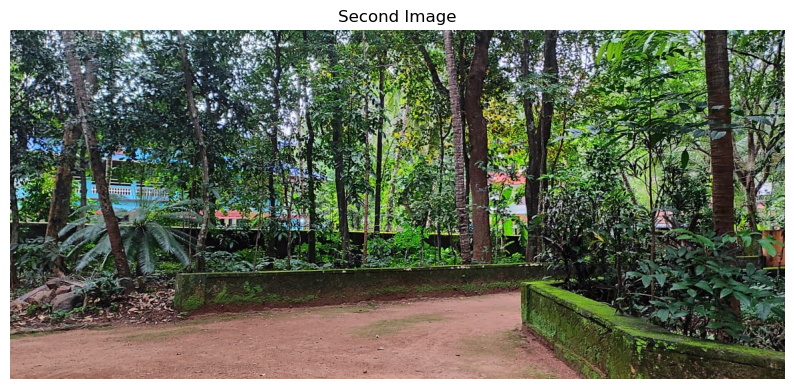

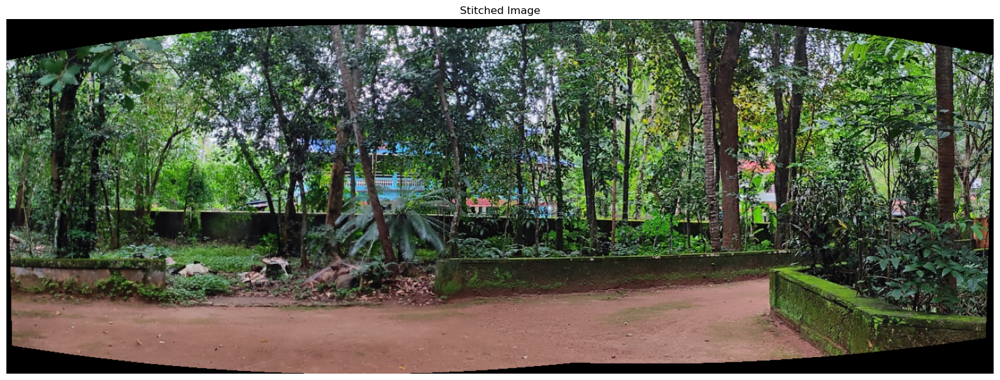

In [22]:
import cv2 
import matplotlib.pyplot as plt
image_paths=['C://Users//Kisha//OneDrive//Documents//finalYearProject//10_2.jpg','C://Users//Kisha//OneDrive//Documents//finalYearProject//10_3.jpg'] 
imgs = []
for imagePath in image_paths:
    image = cv2.imread(imagePath)
    imgs.append(image)
plt.figure(figsize=(10, 20))
plt.imshow(cv2.cvtColor(imgs[0], cv2.COLOR_BGR2RGB))
plt.title("First Image")
plt.axis('off')  
plt.show()

plt.figure(figsize=(10, 20)) 
plt.imshow(cv2.cvtColor(imgs[1], cv2.COLOR_BGR2RGB))
plt.title("Second Image")
plt.axis('off') 
plt.show()

stitchy=cv2.Stitcher_create() 
(dummy,output)=stitchy.stitch(imgs) 
plt.figure(figsize=(20, 20))  
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title("Stitched Image")
plt.axis('off') 
plt.show()

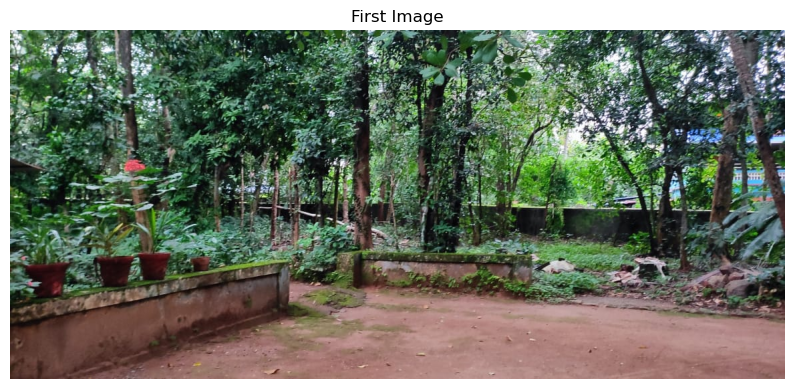

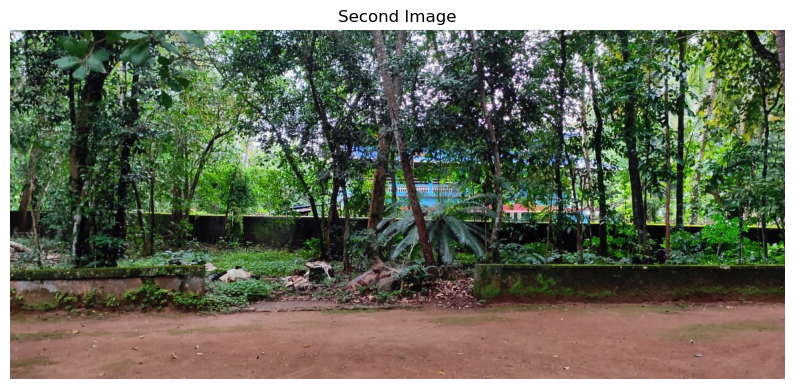

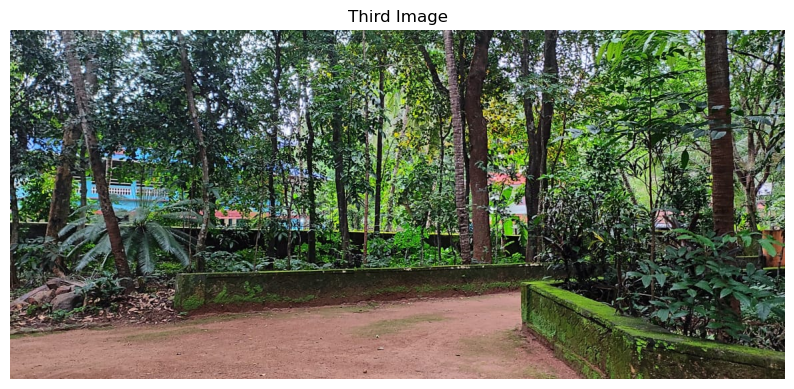

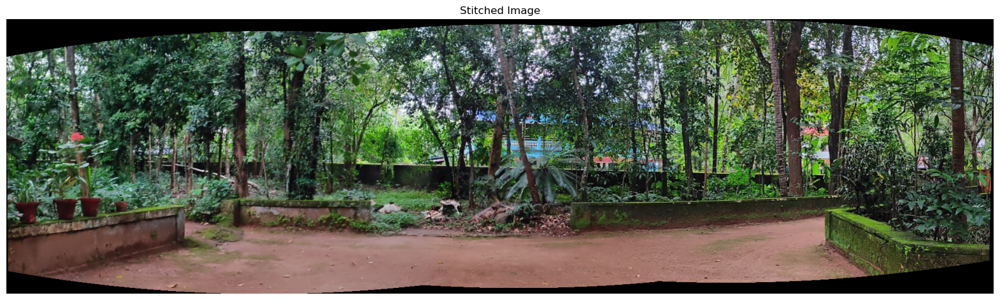

In [23]:
import cv2 
import matplotlib.pyplot as plt
image_paths=['C://Users//Kisha//OneDrive//Documents//finalYearProject//10_1.jpg','C://Users//Kisha//OneDrive//Documents//finalYearProject//10_2.jpg','C://Users//Kisha//OneDrive//Documents//finalYearProject//10_3.jpg'] 
imgs = []
for imagePath in image_paths:
    image = cv2.imread(imagePath)
    imgs.append(image)
plt.figure(figsize=(10, 20))
plt.imshow(cv2.cvtColor(imgs[0], cv2.COLOR_BGR2RGB))
plt.title("First Image")
plt.axis('off')  
plt.show()

plt.figure(figsize=(10, 20)) 
plt.imshow(cv2.cvtColor(imgs[1], cv2.COLOR_BGR2RGB))
plt.title("Second Image")
plt.axis('off') 
plt.show()

plt.figure(figsize=(10, 20)) 
plt.imshow(cv2.cvtColor(imgs[2], cv2.COLOR_BGR2RGB))
plt.title("Third Image")
plt.axis('off') 
plt.show()

stitchy=cv2.Stitcher_create() 
(dummy,output)=stitchy.stitch(imgs) 
plt.figure(figsize=(20, 20))  
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title("Stitched Image")
plt.axis('off') 
plt.show()